# 2.&nbsp;Upload Image Dataset and Prepare Training Data

## 2.2 Split images into train and validation folders

In [ ]:
# Unzip images to a custom data folder
!unzip -q /content/data.zip -d /content/custom_data

In [ ]:
# Split between train and val folders

from pathlib import Path
import random
import os
import sys
import shutil
import argparse


# Define and parse user input arguments

arg_parser = argparse.ArgumentParser() # Changed variable name from 'parser' to 'arg_parser' to avoid conflicts
arg_parser.add_argument('--datapath', help='Path to data folder containing image and annotation files',
                    required=True)
arg_parser.add_argument('--train_pct', help='Ratio of images to go to train folder; \
                    the rest go to validation folder (example: ".8")',
                    default=.8)

# Instead of using args = parser.parse_args(), which expects command-line arguments,
# we'll directly create a Namespace object with the desired values.
args = argparse.Namespace(datapath="/content/custom_data", train_pct=0.9)

data_path = args.datapath
train_percent = float(args.train_pct)

# Check for valid entries
if not os.path.isdir(data_path):
   print('Directory specified by --datapath not found. Verify the path is correct (and uses double back slashes if on Windows) and try again.')
   sys.exit(0)
if train_percent < .01 or train_percent > 0.99:
   print('Invalid entry for train_pct. Please enter a number between .01 and .99.')
   sys.exit(0)
val_percent = 1 - train_percent
# Define path to input dataset
input_image_path = os.path.join(data_path,'images')
input_label_path = os.path.join(data_path,'labels')

# Define paths to image and annotation folders
cwd = os.getcwd()
train_img_path = os.path.join(cwd,'data/train/images')
train_txt_path = os.path.join(cwd,'data/train/labels')
val_img_path = os.path.join(cwd,'data/validation/images')
val_txt_path = os.path.join(cwd,'data/validation/labels')

# Create folders if they don't already exist
for dir_path in [train_img_path, train_txt_path, val_img_path, val_txt_path]:
   if not os.path.exists(dir_path):
      os.makedirs(dir_path)
      print(f'Created folder at {dir_path}.')


# Get list of all images and annotation files
img_file_list = [path for path in Path(input_image_path).rglob('*')]
txt_file_list = [path for path in Path(input_label_path).rglob('*')]

print(f'Number of image files: {len(img_file_list)}')
print(f'Number of annotation files: {len(txt_file_list)}')

# Determine number of files to move to each folder
file_num = len(img_file_list)
train_num = int(file_num*train_percent)
val_num = file_num - train_num
print('Images moving to train: %d' % train_num)
print('Images moving to validation: %d' % val_num)

# Select files randomly and copy them to train or val folders
for i, set_num in enumerate([train_num, val_num]):
  for ii in range(set_num):
    img_path = random.choice(img_file_list)
    img_fn = img_path.name
    base_fn = img_path.stem
    txt_fn = base_fn + '.txt'
    txt_path = os.path.join(input_label_path,txt_fn)

    if i == 0: # Copy first set of files to train folders
      new_img_path, new_txt_path = train_img_path, train_txt_path
    elif i == 1: # Copy second set of files to the validation folders
      new_img_path, new_txt_path = val_img_path, val_txt_path

    shutil.copy(img_path, os.path.join(new_img_path,img_fn))
    #os.rename(img_path, os.path.join(new_img_path,img_fn))
    if os.path.exists(txt_path): # If txt path does not exist, this is a background image, so skip txt file
      shutil.copy(txt_path,os.path.join(new_txt_path,txt_fn))
      #os.rename(txt_path,os.path.join(new_txt_path,txt_fn))

    img_file_list.remove(img_path)


Created folder at /content/data/train/images.
Created folder at /content/data/train/labels.
Created folder at /content/data/validation/images.
Created folder at /content/data/validation/labels.
Number of image files: 199
Number of annotation files: 199
Images moving to train: 179
Images moving to validation: 20


# 3.&nbsp;Install Requirements (Ultralytics)



In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.5/983.5 kB 32.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 69.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 29.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 73.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

# 4.&nbsp;Configure Training


In [ ]:
# Python function to automatically create data.yaml config file
# 1. Reads "classes.txt" file to get list of class names
# 2. Creates data dictionary with correct paths to folders, number of classes, and names of classes
# 3. Writes data in YAML format to data.yaml

import yaml
import os

def create_data_yaml(path_to_classes_txt, path_to_data_yaml):

  # Read class.txt to get class names
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found! Please create a classes.txt labelmap and move it to {path_to_classes_txt}')
    return
  with open(path_to_classes_txt, 'r') as f:
    classes = []
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
  number_of_classes = len(classes)

  # Create data dictionary
  data = {
      'path': '/content/data',
      'train': 'train/images',
      'val': 'validation/images',
      'nc': number_of_classes,
      'names': classes
  }

  # Write data to YAML file
  with open(path_to_data_yaml, 'w') as f:
    yaml.dump(data, f, sort_keys=False)
  print(f'Created config file at {path_to_data_yaml}')

  return

# Define path to classes.txt and run function
path_to_classes_txt = '/content/custom_data/classes.txt'
path_to_data_yaml = '/content/data.yaml'

create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('\nFile contents:\n')
!cat /content/data.yaml

Created config file at /content/data.yaml

File contents:

path: /content/data
train: train/images
val: validation/images
nc: 11
names:
- Ferrari
- Jordan Future
- Jordan One
- New Balance R2002
- New Balance White
- Nike Air Force
- Nike Dunk
- Nike KD
- Nike Vapormax
- Saucony Speed
- Vans


# 5.&nbsp;Train Model

In [ ]:
!yolo detect train data=/content/data.yaml model=yolo11s.pt epochs=60 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 18.4M/18.4M [00:00<00:00, 154MB/s] 
Ultralytics 8.3.115 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, io

The best trained model weights will be saved in `content/runs/detect/train/weights/best.pt`.
Additional information about training is saved in the `content/runs/detect/train` folder, including a `results.png` file that shows how loss, precision, recall, and mAP progressed over each epoch.

#6.&nbsp;Test Model

In [ ]:
!yolo detect predict model=runs/detect/train/weights/best.pt source=data/validation/images save=True

Ultralytics 8.3.115 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,417,057 parameters, 0 gradients, 21.3 GFLOPs

image 1/20 /content/data/validation/images/2672c04a-IMG_3438.jpeg: 640x480 1 New Balance R2002, 1 New Balance White, 1 Nike KD, 64.8ms
image 2/20 /content/data/validation/images/3ce923cf-IMG_3567.jpeg: 640x480 1 Nike Air Force, 1 Nike KD, 14.2ms
image 3/20 /content/data/validation/images/5870e871-IMG_3439.jpeg: 640x480 1 New Balance White, 1 Nike KD, 12.5ms
image 4/20 /content/data/validation/images/74219a89-IMG_3409.jpeg: 480x640 1 Jordan One, 1 New Balance R2002, 1 Nike KD, 69.4ms
image 5/20 /content/data/validation/images/7a1c4a40-IMG_3471.jpeg: 640x480 1 Nike Dunk, 21.8ms
image 6/20 /content/data/validation/images/836b8761-IMG_3531.jpeg: 640x480 1 Nike Dunk, 1 Nike Vapormax, 18.1ms
image 7/20 /content/data/validation/images/8901bfe9-IMG_3434.jpeg: 640x480 1 Nike Air Force, 1 Nike Dunk, 17.0ms
image 8/20 /content/data

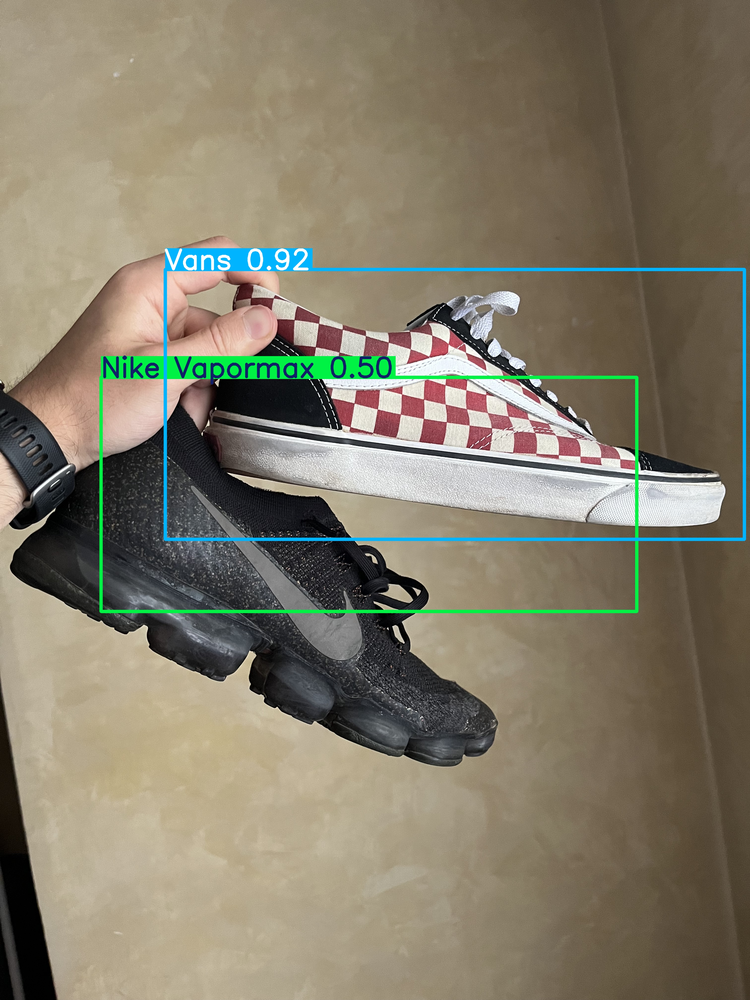

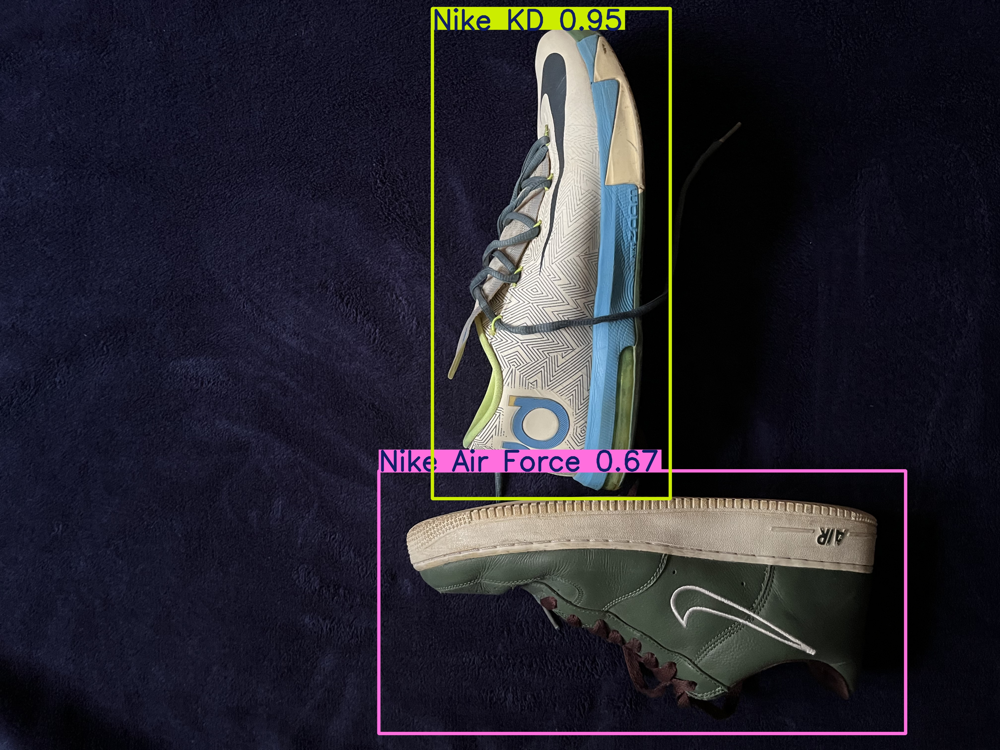

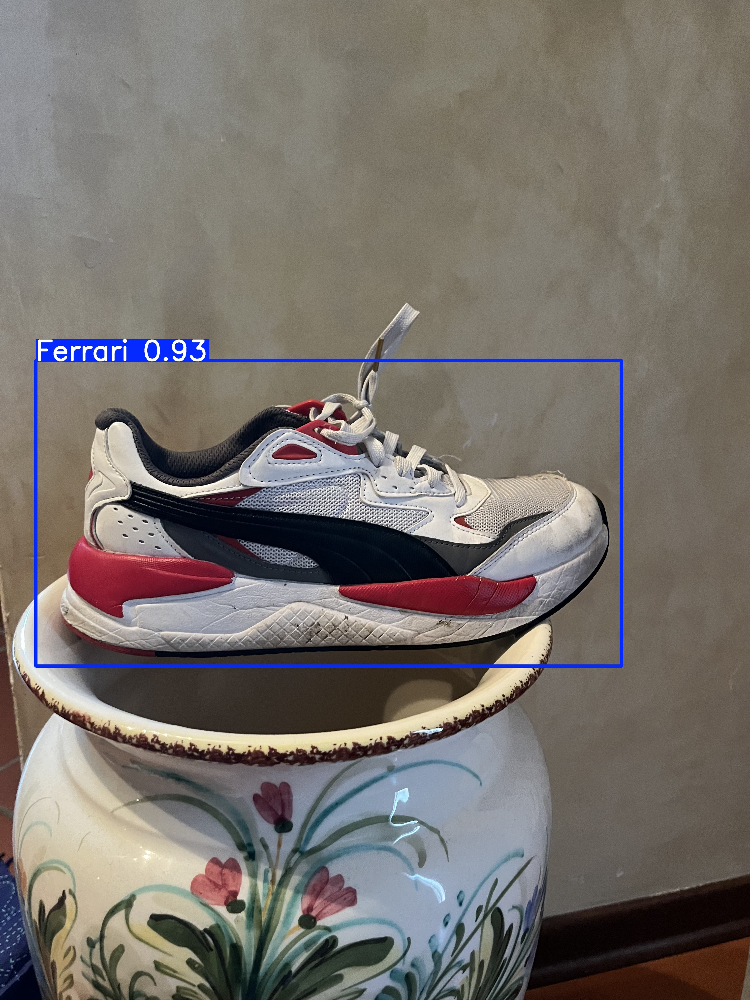

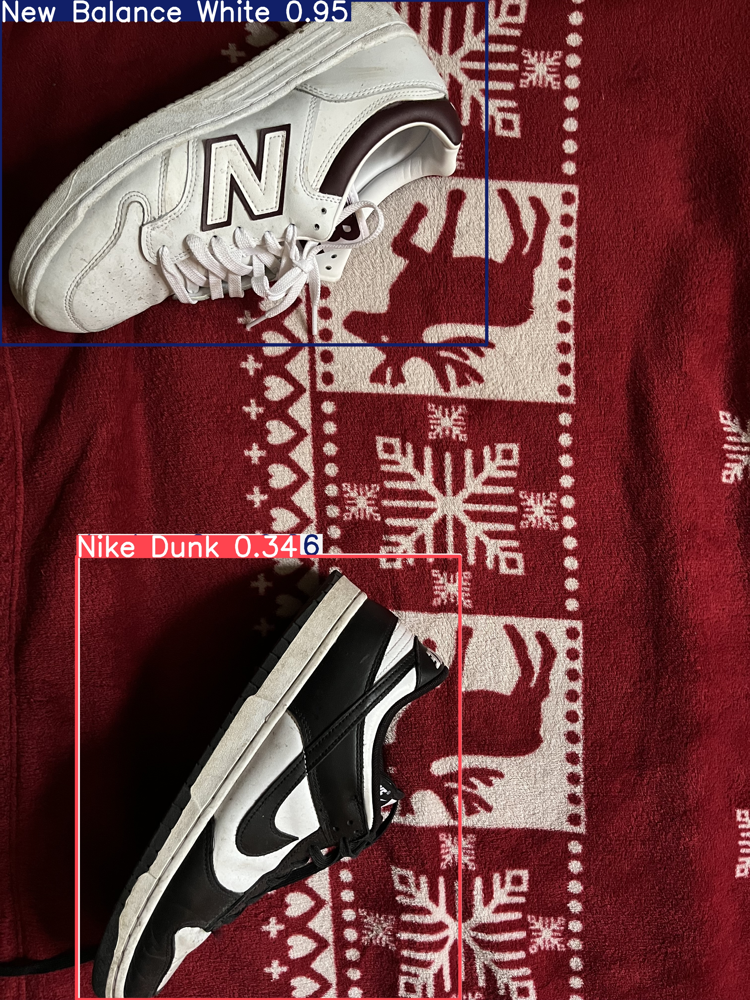

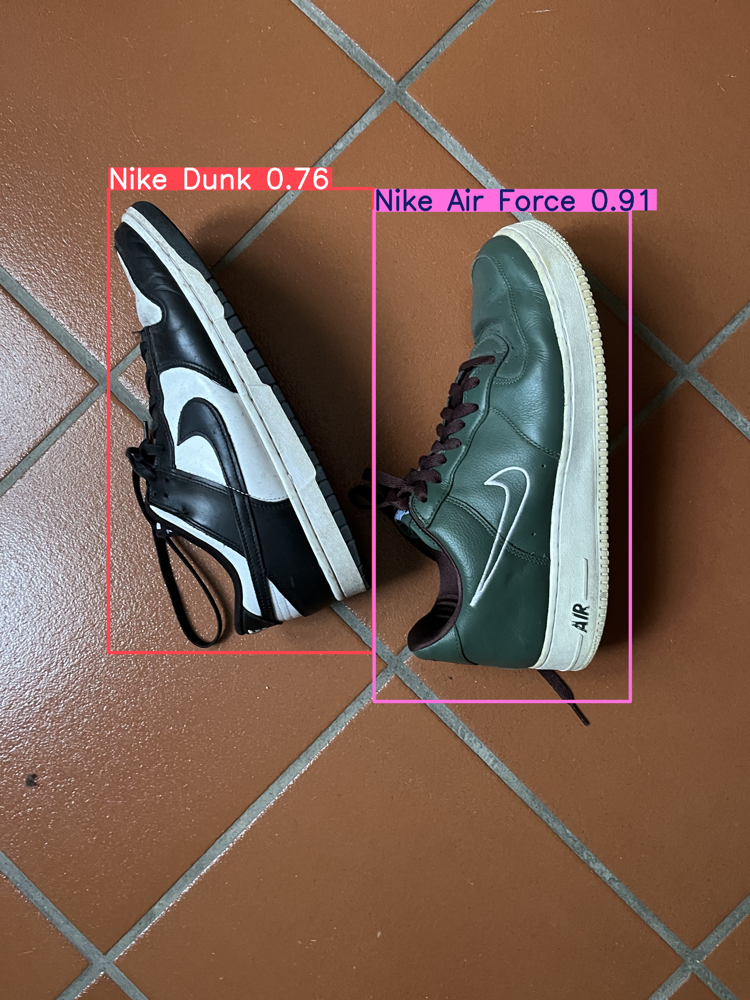

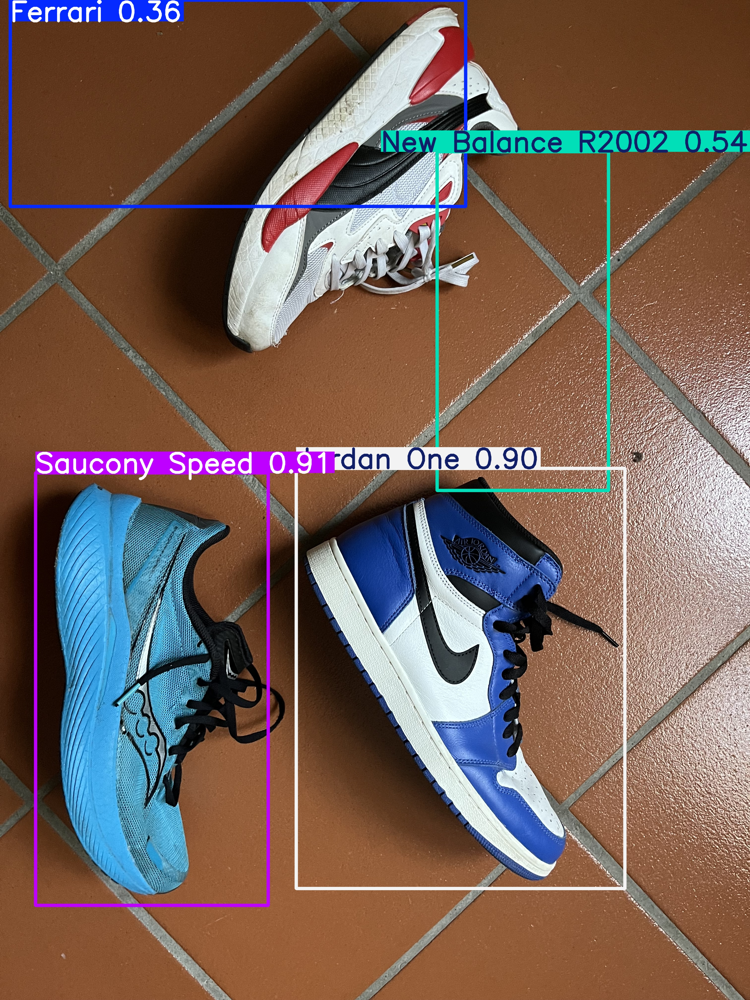

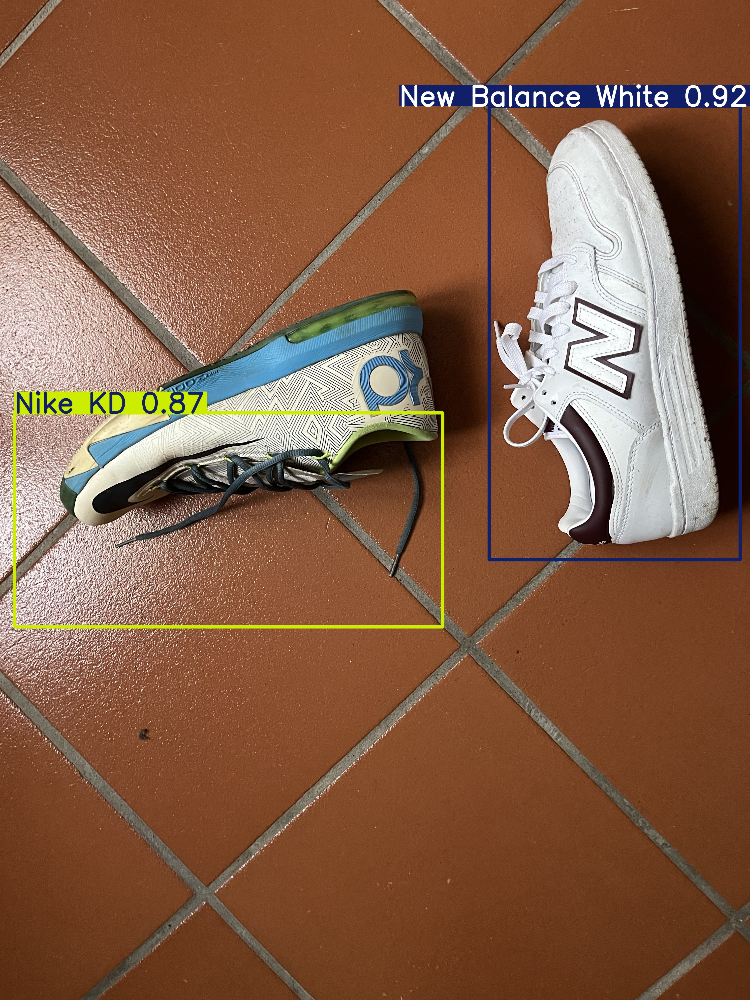

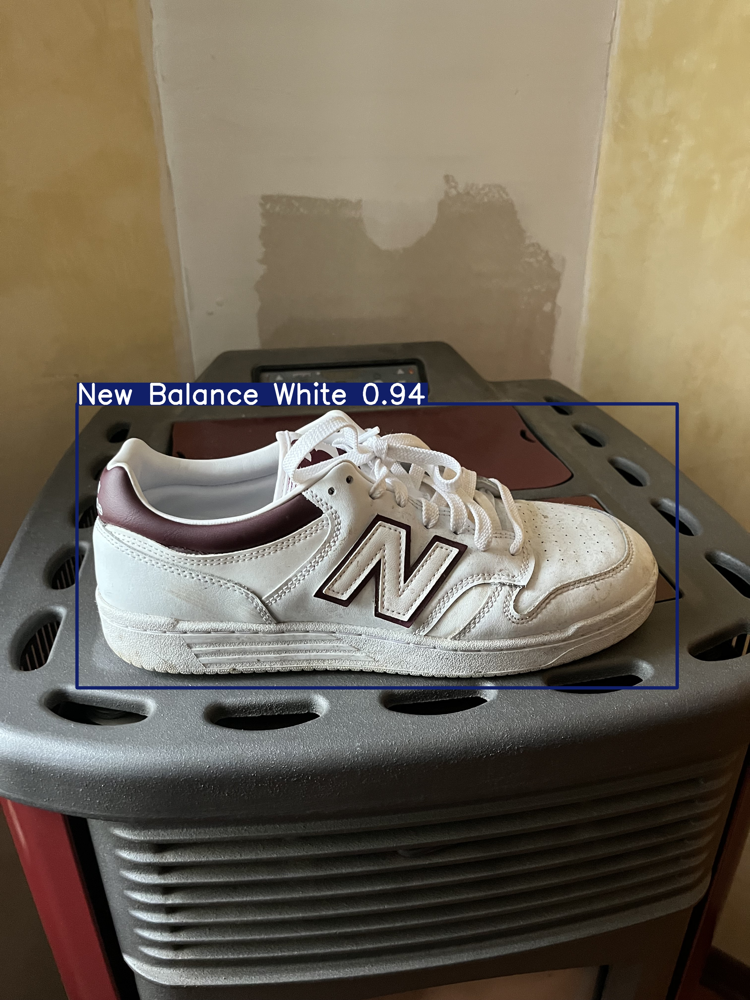

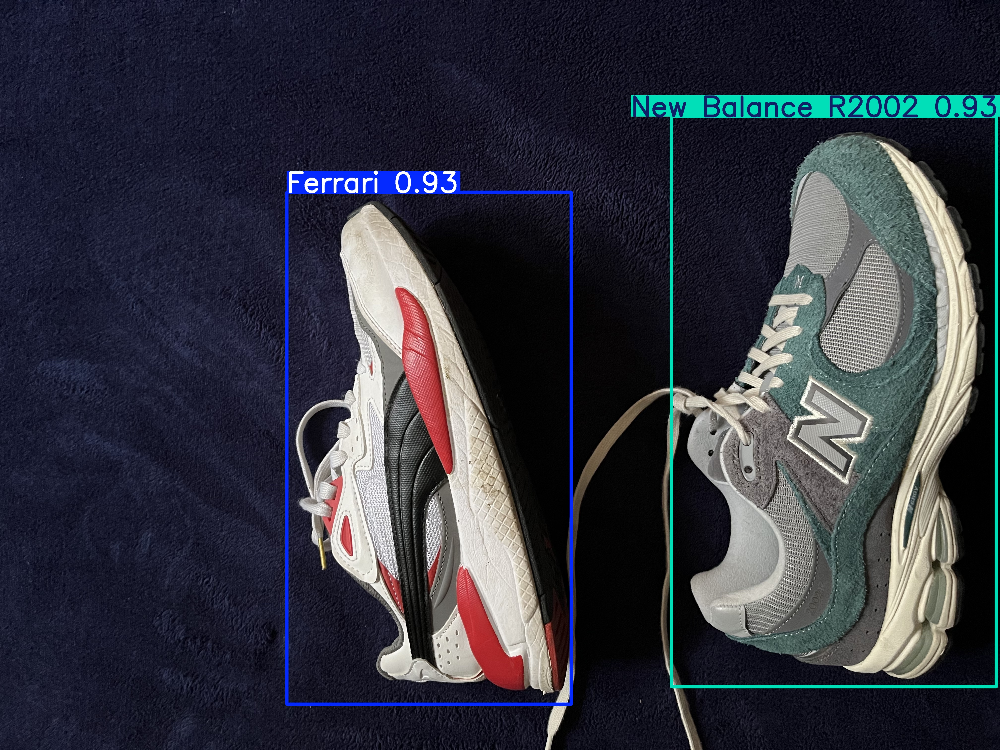

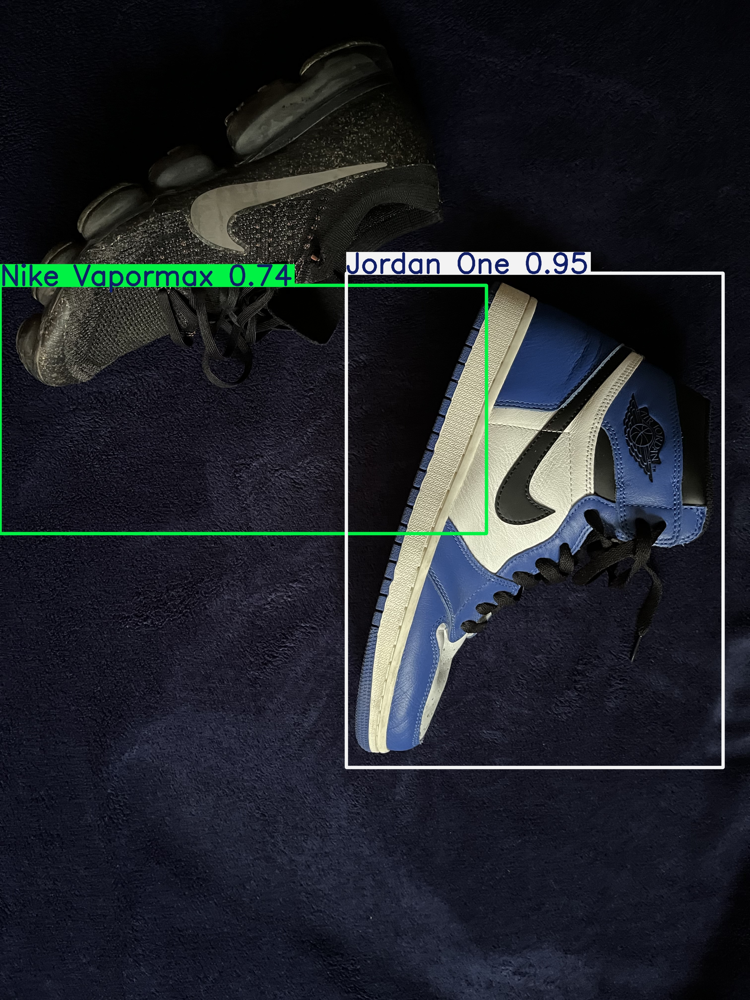

In [ ]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')


#7.&nbsp;Deploy Model

## 7.1 Download YOLO Model


In [ ]:
# Create "my_model" folder to store model weights and train results
!mkdir /content/my_model
!cp /content/runs/detect/train/weights/best.pt /content/my_model/my_model.pt
!cp -r /content/runs/detect/train /content/my_model

# Zip into "my_model.zip"
%cd my_model
!zip /content/my_model.zip my_model.pt
!zip -r /content/my_model.zip train
%cd /content

/content/my_model
  adding: my_model.pt (deflated 8%)
  adding: train/ (stored 0%)
  adding: train/labels.jpg (deflated 27%)
  adding: train/P_curve.png (deflated 6%)
  adding: train/F1_curve.png (deflated 5%)
  adding: train/labels_correlogram.jpg (deflated 46%)
  adding: train/val_batch0_pred.jpg (deflated 8%)
  adding: train/R_curve.png (deflated 8%)
  adding: train/val_batch0_labels.jpg (deflated 9%)
  adding: train/weights/ (stored 0%)
  adding: train/weights/last.pt (deflated 8%)
  adding: train/weights/best.pt (deflated 8%)
  adding: train/confusion_matrix.png (deflated 23%)
  adding: train/PR_curve.png (deflated 17%)
  adding: train/results.csv (deflated 61%)
  adding: train/train_batch1.jpg (deflated 2%)
  adding: train/args.yaml (deflated 53%)
  adding: train/train_batch2.jpg (deflated 3%)
  adding: train/train_batch601.jpg (deflated 6%)
  adding: train/results.png (deflated 6%)
  adding: train/confusion_matrix_normalized.png (deflated 20%)
  adding: train/train_batch0.jpg (d

In [ ]:
# This takes forever for some reason, you can also just download the model from the sidebar
from google.colab import files

files.download('/content/my_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>